> **Instruções importantes**

Clique na célula abaixo e execute-a pressionando **Shift + Enter**, ou navegando até o menu **Run → Run Selected Cell**.

⚠️ Essa célula pode levar alguns minutos para ser executada, pois realiza o download da pasta `datasets`, com aproximadamente **1,29 GB** de dados.


In [ ]:
!pip -q install -r requirements.txt
import gdown
import zipfile
file_id = "1J_xX67KyPMur5viXW_St22T1GbvmphjE"
output = "datasets.zip"

gdown.download(id=file_id, output=output, quiet=False)

with zipfile.ZipFile(output, 'r') as zip_ref:
    zip_ref.extractall(".") 

print("Download e extração concluídos.")


# Índice
- [2.1 Trabalhando com Dados Vetoriais](#21-trabalhando-com-dados-vetoriais)
- [2.2 Trabalhando com Dados Rasters](#22-trabalhando-com-dados-raster)
- [2.3 Raster ou Vetorial](#23-raster-ou-vetorial)

# 2. Tipos de Dados Geoespaciais <a class="anchor" id="first-bullet"></a>
Objetivo: Aprender a manipular arquivos geoespaciais (shapefiles, GeoJSON, raster) e transformá-los para análise.



## 2.1 Trabalhando com Dados Vetoriais

Os dados vetoriais são representações espaciais baseadas em pontos, linhas e polígonos. Esses dados são amplamente utilizados em aplicações geoespaciais para modelar características do mundo real, como limites políticos, rodovias, rios e infraestrutura urbana.

Um dos formatos mais comuns para armazenar dados vetoriais é o **Shapefile (.shp)**, desenvolvido pela ESRI. Ele é composto por múltiplos arquivos auxiliares (como pode ser visto no diretorio datasets/Brasil_UF):
- **.shp**: Armazena a geometria dos objetos espaciais.
- **.shx**: Índice espacial das geometrias.
- **.dbf**: Tabela de atributos contendo informações descritivas sobre os objetos.
- **.prj**: Define o sistema de coordenadas do arquivo.


Neste notebook, vamos carregar um shapefile contendo os limites das unidades federativas do Brasil e explorar sua estrutura.

In [1]:
import geopandas as gpd

#Usando ShapeFile
BASE_DIR = "datasets"
shapefile_path = f"{BASE_DIR}/RJ_2023/RJ_Municipios_2023.shp"  # Shapefile das Unidades da Federacao brasileira
gdf_shp = gpd.read_file(shapefile_path)

gdf_shp.head()

,CD_MUN,NM_MUN,CD_RGI,NM_RGI,CD_RGINT,NM_RGINT,CD_UF,NM_UF,CD_REGIAO,NM_REGIAO,CD_CONCURB,NM_CONCURB,AREA_KM2,geometry
0,3300100,Angra dos Reis,330002,Angra dos Reis,3301,Rio de Janeiro,33,Rio de Janeiro,3,Sudeste,3300100,Angra dos Reis,813.420,"MULTIPOLYGON (((-44.51649 -23.03589, -44.51633..."
1,3300159,Aperibé,330012,Santo Antônio de Pádua,3304,Campos dos Goytacazes,33,Rio de Janeiro,3,Sudeste,None,None,94.542,"POLYGON ((-42.11437 -21.61204, -42.11394 -21.6..."
2,3300209,Araruama,330013,Cabo Frio,3305,Macaé - Rio das Ostras - Cabo Frio,33,Rio de Janeiro,3,Sudeste,3300209,Araruama/RJ,638.276,"POLYGON ((-42.28399 -22.93928, -42.28444 -22.9..."
3,3300225,Areal,330007,Petrópolis,3303,Petrópolis,33,Rio de Janeiro,3,Sudeste,3303906,Petrópolis/RJ,110.724,"POLYGON ((-43.09004 -22.23844, -43.09135 -22.2..."
4,3300233,Armação dos Búzios,330013,Cabo Frio,3305,Macaé - Rio das Ostras - Cabo Frio,33,Rio de Janeiro,3,Sudeste,3300704,Cabo Frio/RJ,70.977,"MULTIPOLYGON (((-41.88151 -22.74808, -41.88153..."


Outro formato bastante utilizado é o **GeoJSON (.geojson)**, que é baseado em JSON e amplamente adotado devido à sua compatibilidade com aplicações web. A maior diferença entre esses dataframes e um dataframe comum é a coluna geometry, que contém objetos espaciais do tipo POLYGON ou MULTIPOLYGON que representam áreas geográficas com coordenadas de latitude e longitude.


In [2]:
#Usando GeoJson
geojson_path = f"{BASE_DIR}/br_states.json"
gdf = gpd.read_file(geojson_path)

gdf.head()

,id,FID_Export,SIGLA,Total,Homens,Mulheres,Urbana,Rural,TX_Alfab,FID_estado,Estado,FK_macro,PK_sigla,geometry
0,AC,0,AC,557526,280983,276543,370267,187259,65.154545,-1,Acre,N,AC,"MULTIPOLYGON (((-66.80619 -9.81446, -66.64485 ..."
1,AL,1,AL,2822621,1378942,1443679,1919739,902882,59.364356,-1,Alagoas,NE,AL,"MULTIPOLYGON (((-35.15263 -8.91373, -35.15628 ..."
2,AM,2,AM,2812557,1414367,1398190,2107222,705335,72.250000,-1,Amazonas,N,AM,"MULTIPOLYGON (((-67.3259 2.02976, -67.30001 1...."
3,AP,3,AP,477032,239453,237579,424683,52349,83.650000,-1,Amapá,N,AP,"MULTIPOLYGON (((-50.09389 0.70205, -50.15695 0..."
4,BA,4,BA,13070250,6462033,6608217,8772348,4297902,71.163373,-1,Bahia,NE,BA,"MULTIPOLYGON (((-38.64899 -18.03612, -38.65822..."


### Exibir informações gerais do GeoDataFrame

In [3]:
gdf_shp.info() 
print("\n-----\n")
gdf_shp.crs # Verificar a projeção cartográfica

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 92 entries, 0 to 91
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   CD_MUN      92 non-null     object  
 1   NM_MUN      92 non-null     object  
 2   CD_RGI      92 non-null     object  
 3   NM_RGI      92 non-null     object  
 4   CD_RGINT    92 non-null     object  
 5   NM_RGINT    92 non-null     object  
 6   CD_UF       92 non-null     object  
 7   NM_UF       92 non-null     object  
 8   CD_REGIAO   92 non-null     object  
 9   NM_REGIAO   92 non-null     object  
 10  CD_CONCURB  49 non-null     object  
 11  NM_CONCURB  49 non-null     object  
 12  AREA_KM2    92 non-null     float64 
 13  geometry    92 non-null     geometry
dtypes: float64(1), geometry(1), object(12)
memory usage: 10.2+ KB

-----



<Geographic 2D CRS: EPSG:4674>
Name: SIRGAS 2000
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Latin America - Central America and South America - onshore and offshore. Brazil - onshore and offshore.
- bounds: (-122.19, -59.87, -25.28, 32.72)
Datum: Sistema de Referencia Geocentrico para las AmericaS 2000
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

### Visualizacao do shapefile usando Folium

In [4]:
import folium

# Mapa centralizado no Brasil
mapa = folium.Map(location=[-22.9068, -43.1729], zoom_start=8)

# Adicionando os limites das unidades federativas como o GeoJson
for _, row in gdf_shp.iterrows():
    folium.GeoJson(
        row["geometry"],
        name=row["NM_MUN"],
        tooltip=str(row["AREA_KM2"]) + " km²",
        style_function=lambda x: {"color": "blue"},
    ).add_to(mapa)


mapa

## 2.2 Trabalhando com Dados Raster

Os dados raster representam superfícies contínuas e são compostos por uma grade regular de células (pixels).
Eles são usados para representar imagens de satélite, modelos digitais de elevação (MDE) e outras informações geoespaciais.
Cada pixel contém um valor que representa uma característica da superfície.

Como os dados raster funcionam como um bitmap (ou seja, uma matriz de valores organizados em células/pixels), eles permitem representar informações contínuas sobre superfícies geográficas. O formato TIFF (Tagged Image File Format), especialmente na sua variação GeoTIFF, é amplamente utilizado para armazenar dados raster geoespaciais. Ele já vem com metadados embutidos, o que facilita a extração de informações espaciais e a integração com ferramentas de análise geográfica. 

In [5]:
import rasterio


arquivo_raster = f"{BASE_DIR}/World_Temp_geotiff/data/TEMP.tif"

# Carrega um arquivo raster da temperatura global
with rasterio.open(arquivo_raster) as src:
    print(f"Formato: {src.driver}")
    print(f"Dimensões (Linhas, Colunas): {src.height}, {src.width}")
    print(f"Número de bandas: {src.count}")
    print(f"Sistema de Coordenadas: {src.crs}")


Formato: GTiff
Dimensões (Linhas, Colunas): 15000, 43200
Número de bandas: 1
Sistema de Coordenadas: EPSG:4326


### Extraindo e Visualizando os Dados
Os dados raster geralmente possuem múltiplas bandas (camadas). Vamos visualizar a primeira banda da imagem:

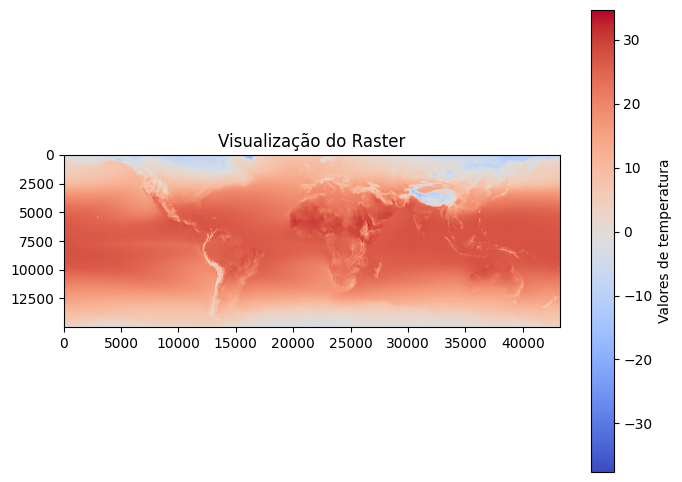

In [6]:
import numpy as np
import matplotlib.pyplot as plt

# Lendo a primeira banda do raster
with rasterio.open(arquivo_raster) as src:
    raster_data = src.read(1)  # Lendo a primeira banda

# Visualizando a matriz raster
plt.figure(figsize=(8, 6))
plt.imshow(raster_data, cmap="coolwarm")	
plt.colorbar(label="Valores de temperatura")
plt.title("Visualização do Raster")
plt.show()


**Estatísticas Básicas do Raster**

A partir dessa matriz ja eh possivel extrair algumas informacoes que podem ser interessentes

In [7]:
print(f"Mínima Temperatura: {np.min(raster_data)}")
print(f"Máxima Temperatura: {np.max(raster_data)}")
print(f"Temperatura Média: {np.mean(raster_data)}")
print(f"Desvio Padrao: {np.std(raster_data)}")

Mínima Temperatura: -37.625
Máxima Temperatura: 34.6875
Temperatura Média: 16.132246017456055
Desvio Padrao: 9.931319236755371


**Recorte de Raster Usando um Shapefile (Rio de Janeiro)**

É comum precisar recortar um raster para uma área de interesse usando um shapefile (usaremos o shp do Rio utilizado na Secao 1.1). Podemos fazer isso com rasterio.mask:

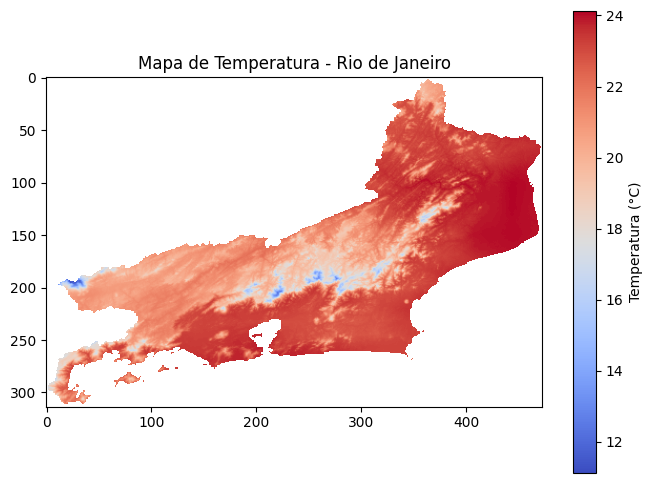

In [8]:
from rasterio.mask import mask

# Carregar o shapefile
rio = gpd.read_file(shapefile_path)

# Abrir o raster e recortar com base na geometria do shapefile
with rasterio.open(arquivo_raster) as src:
    rio = rio.to_crs(src.crs)  # Garantir que ambos têm o mesmo sistema de coordenadas
    out_image, out_transform = mask(src, rio.geometry, crop=True, filled=True, nodata=np.nan)
    out_meta = src.meta.copy()
    out_meta.update({
        "driver": "GTiff",
        "height": out_image.shape[1],
        "width": out_image.shape[2],
        "transform": out_transform,
        "nodata": np.nan
    })

# Substituir zeros por NaN (opcional, caso `nodata=np.nan` não funcione automaticamente)
out_image = out_image.astype('float32')
out_image[out_image == 0] = np.nan

# Exibir o raster recortado (Mapa de Temperatura)
plt.figure(figsize=(8, 6))
plt.imshow(out_image[0], cmap="coolwarm")
plt.colorbar(label="Temperatura (°C)")
plt.title("Mapa de Temperatura - Rio de Janeiro")
plt.show()


In [9]:
import numpy as np

# Filtrar apenas os valores válidos (excluindo NoData)
valid_pixels = out_image[0][out_image[0] > 0]  # Temperaturas reais devem estar acima de -50°C

# Cálculo das estatísticas
temp_min = np.min(valid_pixels)
temp_max = np.max(valid_pixels)
temp_mean = np.mean(valid_pixels)
temp_std = np.std(valid_pixels)

print(f"Estatísticas de Temperatura do Rio de Janeiro:")
print(f"Temperatura mínima: {temp_min:.2f} °C")
print(f"Temperatura máxima: {temp_max:.2f} °C")
print(f"Temperatura média: {temp_mean:.2f} °C")
print(f"Desvio padrão: {temp_std:.2f} °C")


Estatísticas de Temperatura do Rio de Janeiro:
Temperatura mínima: 11.12 °C
Temperatura máxima: 24.12 °C
Temperatura média: 21.90 °C
Desvio padrão: 1.79 °C


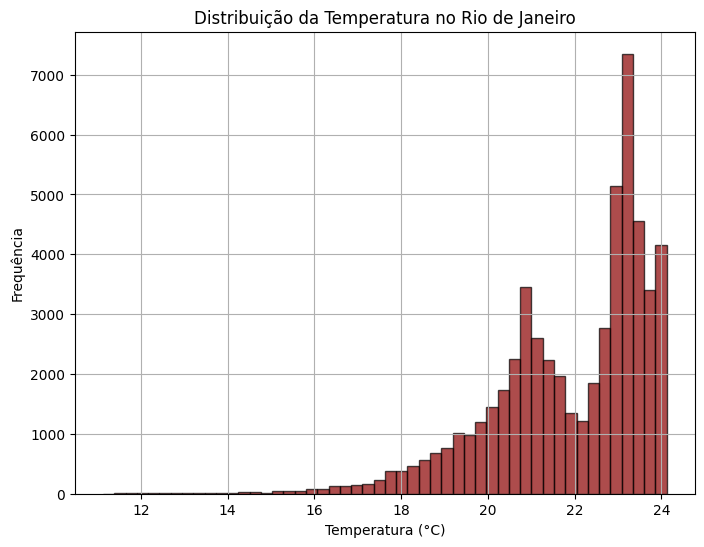

In [10]:
plt.figure(figsize=(8, 6))
plt.hist(valid_pixels, bins=50, color="darkred", alpha=0.7, edgecolor="black")
plt.xlabel("Temperatura (°C)")
plt.ylabel("Frequência")
plt.title("Distribuição da Temperatura no Rio de Janeiro")
plt.grid(True)
plt.show()


**Salvando um Novo Raster**

In [11]:
with rasterio.open(
    "novo_raster.tif",
    "w",
    driver="GTiff",
    height=out_image.shape[1],
    width=out_image.shape[2],
    count=1,
    dtype=out_image.dtype,
    crs=src.crs,
    transform=out_transform,
) as dest:
    dest.write(out_image[0], 1)


## 2.3 Raster ou Vetorial

Nesta seção, vamos entender a diferença entre os dois formatos mais usados em geociência:

- **Raster**: representações contínuas em grade de pixels (como imagens)
- **Vetorial**: representações geométricas precisas (pontos, linhas, polígonos)

Além da explicação teórica, vamos visualizar a diferença usando dados reais.

### 📊 Comparativo entre Raster e Vetorial

| Tipo de dado | Representação | Estrutura | Exemplo |
|--------------|----------------|-----------|---------|
| **Raster**   | Grade de pixels (imagem) | Matriz regular (grid) | Temperatura, altitude, satélite |
| **Vetorial** | Pontos, linhas e polígonos | Tabelado + geometria | Localização de imóveis, limites de bairros |


# Índice
- [3.1 Geocoding e Geocoding Reverso](#31-geocoding-e-geocoding-reverso)
- [3.2 Projeções Cartográficas](#32-projecoes-cartograficas)
- [3.3 Interseções de Camadas Geoespaciais](#33-intersecoes-de-camadas-geoespaciais)
- [3.4 Interpolação Espacial Kriging](#34-interpolacao-espacial-kriging)


# 3. Processamento e Pré-processamento de Dados Geoespaciais

> Nesta seção, vamos explorar operações fundamentais de pré-processamento de dados geoespaciais, essenciais para preparar os dados para análises e modelagens mais avançadas. Cada tópico será acompanhado de uma aplicação prática.

## 3.1 Geocoding e Geocoding Reverso

> O geocoding é o processo de converter um endereço (como "Cristo Redentor, Rio de Janeiro") em coordenadas geográficas (latitude e longitude). Já o geocoding reverso realiza o caminho oposto: ele transforma coordenadas em um endereço textual.

 ##### Exemplo de Geocoding (endereço -> coordenadas)

> A partir da string `"Cristo Redentor, Rio de Janeiro"` é possível obter a latitude e longitude do Cristo Redentor no Rio de Janeiro

In [1]:
import numpy as np
from geopy.geocoders import Nominatim # Servico de Geocoding fornecido pelo OpenSteetMap

geolocator = Nominatim(user_agent="geoapi") # 
location = geolocator.geocode("Cristo Redentor, Rio de Janeiro")

print("Coordenadas do Cristo Redentor:")
print(f"Latitude: {location.latitude}, Longitude: {location.longitude}")


Coordenadas do Cristo Redentor:
Latitude: -22.9519173, Longitude: -43.2104585


##### Exemplo de Geocoding Reverso (coordenadas -> endereço)
> A partir das coordenadas do Cristo `Latitude: -22.9519173, Longitude: -43.2104585`  é possível obter o endereço aproximado

In [2]:
reverse_location = geolocator.reverse((location.latitude, location.longitude), language="pt")
print("\nEndereço reverso aproximado:")
print(reverse_location.address)


Endereço reverso aproximado:
Cristo Redentor, Cristo del Corcovado, Alto da Boa Vista, Rio de Janeiro, Região Geográfica Imediata do Rio de Janeiro, Região Metropolitana do Rio de Janeiro, Região Geográfica Intermediária do Rio de Janeiro, Rio de Janeiro, Região Sudeste, 22470-180, Brasil


##### Plotando Coordenadas em mapas
> Depois de converter um endereço em coordenadas geográficas (geocoding), podemos plotar o ponto em um mapa usando a biblioteca `folium`.

In [3]:
import folium
m = folium.Map(location=[location.latitude, location.longitude], zoom_start=15)
folium.Marker([location.latitude, location.longitude], popup='Cristo Redentor').add_to(m)
m

##### `Aplicação: Transformando Endereços em Coordenadas`

Vamos aplicar o processo de geocodificação em um conjunto de dados real para converter endereços em coordenadas geográficas.

>Neste exemplo, vamos trabalhar com um dataset real de revenda de apartamentos públicos (HDB flats) em Singapura. A ideia é simples: **usar localização para encontrar boas oportunidades de compra**.
>
>Vamos aplicar técnicas geoespaciais simples para entender se um imóvel está caro ou barato comparado à sua vizinhança. Isso pode ser extremamente útil para investidores, compradores ou até para políticas públicas de habitação.
>
>**Passo a passo:**
>
>- **Geocodificar os endereços**: transformar o endereço dos imóveis em coordenadas geográficas (latitude e longitude) para poder colocá-los no mapa.
>- **Mapear os imóveis no espaço**: visualizar onde estão localizados e associá-los aos bairros ou regiões de interesse.
>- **Analisar a variação de preços por localização**: calcular o valor por metro quadrado e comparar com a média da região para descobrir quais imóveis estão "fora da curva".
>
  *Essa análise ajuda a enxergar padrões que números soltos não mostram — como duas casas com o mesmo preço, mas em localizações bem diferentes.*


O script abaixo automatiza o geocoding de endereços no dataset de imóveis `sg-resale-flat-prices-2017-onwards.csv`, transformando cada endereço em coordenadas geográficas (latitude e longitude).

Ele é necessario pois como a API do OpenStreetMap limita 60 requisicões por minuto, é necessario pré-processar e criar o dataset em que faremos as analises. 

> *Alem disso, ele que irá "traduzir" os enderecos para coordenadas.*

In [4]:
import pandas as pd
import time
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

rodar = False #Coloque True se deseja Rodar o Script

if rodar:
    # Carregar dataset original
    df = pd.read_csv("datasets/Singapore/sg-resale-flat-prices-2017-onwards.csv")

    #Criando uma Coluna 'endereco' com o  bloco + rua, cidade, Singapore
    #Exemplo: "330 SEMBAWANG CL, SEMBAWANG, Singapore"
    df["endereco"] = df["block"] + " " + df["street_name"] + ", " + df["town"] + ", Singapore"
    
    # Geocodificador
    geolocator = Nominatim(user_agent="geoapi_sg_full")
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1)
    
    # Tentar carregar resultados anteriores
    try:
        df_geo = pd.read_csv("datasets/Singapore/geocodificados.csv")
        processados = set(df_geo["endereco"])
        print(f"Retomando, {len(processados)} endereços já processados.")
    except FileNotFoundError:
        df_geo = pd.DataFrame()
        processados = set()
    
    novos = []
    batch_size = 50
    pause_seconds = 60
    
    # Iniciar processamento por blocos
    for i, row in df.iterrows():
        endereco = row["endereco"]
        if endereco in processados:
            continue
        
        try:
            location = geocode(endereco)
            lat = location.latitude if location else None
            lon = location.longitude if location else None
        except:
            lat, lon = None, None
    
        # Copiar a linha original e adicionar coordenadas
        nova_linha = row.copy()
        nova_linha["latitude"] = lat
        nova_linha["longitude"] = lon
        novos.append(nova_linha)
    
        print(f"{len(novos)} -> {endereco} => ({lat}, {lon})")
    
        if len(novos) % batch_size == 0:
            df_novos = pd.DataFrame(novos)
            df_geo = pd.concat([df_geo, df_novos], ignore_index=True).drop_duplicates(subset=["endereco"])
            df_geo.to_csv("datasets/Singapore/geocodificados.csv", index=False)
            print(f"📝 Salvo após {len(novos)} registros.")
            novos.clear()
            print(f"⏸️ Pausando por {pause_seconds} segundos...")
            time.sleep(pause_seconds)
    
    # Salvar o restante
    if novos:
        df_novos = pd.DataFrame(novos)
        df_geo = pd.concat([df_geo, df_novos], ignore_index=True).drop_duplicates(subset=["endereco"])
        df_geo.to_csv("datasets/Singapore/geocodificados.csv", index=False)
        print("✅ Processamento finalizado.")
    

> Agora, Com o dataset `geocodificados.csv` já é possivel montar um simples Mapa Com os pontos desses imoveis

In [5]:
# Carregar os dados ja pre-processados 
df = pd.read_csv("datasets/Singapore/geocodificados.csv")

# Amostrar para testes rápidos
df_amostra = df.sample(n=30, random_state=42).copy()
df = df.dropna()
m = folium.Map(location=[1.3521, 103.8198], zoom_start=12, tiles="CartoDB Positron")

folium.GeoJson(
    "datasets/Singapore/singapore_boundary.geojson",  
    name="Limite de Singapura",
    style_function=lambda feature: {
        "color": "#2c7fb8",         # azul mais suave
        "weight": 1,
        "fillColor": "#a6bddb",
        "fillOpacity": 0.2

    }
).add_to(m)

for _, row in df.iterrows():
    endereco = row["endereco"]
    popup_text = f"<b>Endereço:</b> {endereco}<br>"
    
    folium.CircleMarker(
        location=(row["latitude"], row["longitude"]),
        radius=6,
        color='white',
        fill_color='green',
        fill=True,
        fill_opacity=0.75,
        popup=folium.Popup(popup_text, max_width=250)
    ).add_to(m)



# Adicionar controle de camadas
folium.LayerControl().add_to(m)

m

#####  Mapa Interativo: Distribuição Espacial dos Preços por m²

>| Faixa | Critério | Cor |
>|-------|----------|-----|
>| **Barato** | Preço/m² abaixo do 1º quartil (Q1) | 🟢 Verde |
>| **Na média** | Entre Q1 e Q3 (mediana) | 🟠 Laranja |
>| **Caro** | Acima do 3º quartil (Q3) | 🔴 Vermelho |

In [6]:
import folium
from folium.plugins import MarkerCluster

# Calcular o preço por m²
df["preco_m2"] = df["resale_price"] / df["floor_area_sqm"]

# Calcular quartis
q1 = df["preco_m2"].quantile(0.25)
q3 = df["preco_m2"].quantile(0.75)

# Função de cor baseada nos quartis
def cor_por_preco_m2(valor):
    if valor < q1:
        return "green"
    elif valor > q3:
        return "red"
    else:
        return "orange"

# Criar o mapa
m = folium.Map(location=[1.3521, 103.8198], zoom_start=12, tiles="CartoDB positron")

# Adicionar camada com o limite de Singapura
folium.GeoJson(
    "datasets/Singapore/singapore_boundary.geojson",  
    name="Limite de Singapura",
    style_function=lambda feature: {
        "color": "#2c7fb8",
        "weight": 1,
        "fillColor": "#a6bddb",
        "fillOpacity": 0.2
    }
).add_to(m)


# Adicionar marcadores ao cluster
for _, row in df.iterrows():
    preco_total = row["resale_price"]
    preco_m2 = row["preco_m2"]
    popup_text = (
        f"<b>Preço total:</b> ${preco_total:,.0f}<br>"
        f"<b>Área:</b> {row['floor_area_sqm']} m²<br>"
        f"<b>Preço/m²:</b> ${preco_m2:,.0f}<br>"
        f"<b>Tipo:</b> {row['flat_type']}"
    )
    folium.CircleMarker(
        location=(row["latitude"], row["longitude"]),
        radius=6,
        color="black",  # contorno
        fill=True,
        fill_color=cor_por_preco_m2(preco_m2),
        fill_opacity=0.85,
        popup=folium.Popup(popup_text, max_width=250)
    ).add_to(m)

# Controles
folium.LayerControl().add_to(m)

print(f"{len(df)} imóveis plotados com cores baseadas em preço/m².")
m


1404 imóveis plotados com cores baseadas em preço/m².


##### Conclusão

 Com base apenas nos endereços textuais, conseguimos:
 
> - Localizar imóveis no mapa
> - Visualizar a distribuição espacial dos preços
> - Preparar os dados para análises 

 Isso mostra como geocoding pode ser usado como uma ponte entre dados tradicionais e geoespaciais.


## 3.2 Projecoes Cartograficas

  Projeções cartográficas são transformações matemáticas que convertem a superfície curva da Terra (esferoide) em uma superfície plana (mapa). Como não é possível representar  perfeitamente uma esfera em um plano, cada projeção faz **compromissos entre preservar forma, área, distância ou direção**.


 ### Por que isso importa?
  
  Para muitas análises espaciais — como **cálculo de área, distância entre pontos, buffers e rotas** — é essencial que os dados estejam em uma **projeção apropriada**. A maioria dos  > dados geográficos brutos vem no sistema **WGS84** (EPSG:4326), que usa latitude e longitude (graus), mas não é adequado para medições métricas.
>  
>  #### Exemplos de Projeções
>  
>  - **WGS84 (EPSG:4326)**: padrão global, usa graus. Bom para visualização, ruim para cálculos.
>  - **UTM (Universal Transverse Mercator)**: divide o globo em zonas com projeção métrica, ideal para cálculos de distância e área em regiões menores.
>  - **Albers Equal Area**: preserva área, útil para análise de distribuição espacial em grandes regiões.
>  

 **Aplicação:** Transformar um dataset de coordenadas geográficas (WGS84) para projeção métrica (UTM), facilitando o cálculo de distâncias reais.

In [7]:
import geopandas as gpd

# Carregando shapefile dos municípios do RJ
shapefile_path = "datasets/RJ_2023/RJ_Municipios_2023.shp"
gdf = gpd.read_file(shapefile_path)

# Selecionar apenas um município (por exemplo, Rio de Janeiro)
rio = gdf[gdf["NM_MUN"] == "Rio de Janeiro"]

# Calcular área no sistema WGS84 (em graus) – NÃO CONFIÁVEL!
area_wgs84 = rio.geometry.area.iloc[0]

# Agora convertemos para UTM zona 23S (projeção métrica adequada)
rio_utm = rio.to_crs(epsg=31983)

# Calcular área no sistema UTM (em metros quadrados) – CONFIÁVEL!
area_utm = rio_utm.geometry.area.iloc[0]

# Mostrar os resultados
print(f"Área no sistema WGS84 (graus²): {area_wgs84}")
print(f"Área no sistema UTM (m²): {area_utm:,.2f}")
print(f"Área no sistema UTM (km²): {area_utm/1e6:,.2f}")


Área no sistema WGS84 (graus²): 0.1056623137465809
Área no sistema UTM (m²): 1,200,125,190.48
Área no sistema UTM (km²): 1,200.13


C:\Users\PC\AppData\Local\Temp\ipykernel_6208\1047340510.py:11: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  area_wgs84 = rio.geometry.area.iloc[0]


#### Exemplo didático: comparação entre WGS84 e UTM com um quadrado de 1 grau x 1 grau

In [8]:
import geopandas as gpd
from shapely.geometry import box

# Criar um quadrado de 1 grau x 1 grau sobre o Brasil (latitude e longitude)
gdf_deg = gpd.GeoDataFrame(geometry=[box(-43, -23, -42, -22)], crs="EPSG:4326")  # perto do RJ

# Calcular a área diretamente (em graus²) — ERRADO
area_graus = gdf_deg.geometry.area.iloc[0]

# Projetar para UTM zona 23S (sistema métrico adequado ao RJ)
gdf_metros = gdf_deg.to_crs(epsg=31983)

# Calcular a área em m² — CORRETO
area_metros = gdf_metros.geometry.area.iloc[0]

# Mostrar a comparação
print(f"Área em WGS84 (graus²): {area_graus}")
print(f"Área em UTM (m²): {area_metros:,.2f}")
print(f"Área em UTM (km²): {area_metros / 1e6:,.2f}")


Área em WGS84 (graus²): 1.0
Área em UTM (m²): 11,403,924,070.61
Área em UTM (km²): 11,403.92


C:\Users\PC\AppData\Local\Temp\ipykernel_6208\3667702788.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  area_graus = gdf_deg.geometry.area.iloc[0]


### `Conclusão`

O valor em graus quadrados não tem interpretação prática direta — ele depende da curvatura da Terra e da latitude! Embora o polígono tenha "1 grau²", isso representa 12 km² reais — e esse valor muda dependendo da latitude (quanto mais longe do equador, menor o "tamanho real" de um grau).

>- Já o valor em metros quadrados, obtido com uma projeção como UTM, é o que você >precisa para:
>
>  - Calcular densidade populacional
>
>  - Estimar área útil de uma zona
>
>  - Fazer modelagem espacial confiável

Se você errar a projeção, você compromete os resultados do modelo.

## 3.3 Intersecoes de Camadas Geoespaciais

> Uma das operações mais poderosas em ciência de dados geoespaciais é a **interseção entre camadas (layers)**. Essa técnica permite responder a perguntas espaciais complexas, como:
> 
> - 🏥 Quais hospitais estão em áreas de risco ambiental?
> - 🌳 Quais bairros têm escolas dentro de zonas verdes?
> - 🚨 Quais ocorrências policiais aconteceram dentro de determinada região?
> 
 Essas respostas emergem ao **cruzar diferentes fontes de dados espaciais** — como a sobreposição de **pontos, linhas e polígonos** com camadas raster (como imagens de satélite ou dados > climáticos).


### Aplicação: `Estações de metrô e Imóveis a venda em São Paulo`

> Neste exemplo, carregamos um arquivo com geometria do limite municipal de São Paulo e o salvamos no formato `geojson`. Esse tipo de conversão é comum quando precisamos reutilizar dados geoespaciais em ferramentas interativas ou compartilhamento entre sistemas. 



In [9]:
import geopandas as gpd

# Carregar o arquivo .json (desde que seja um GeoJSON válido)
gdf_limite = gpd.read_file("datasets/Sao_Paulo/limite_sao_paulo.json")

# Verificar rapidamente
print(gdf_limite.head())

# Salvar como .geojson (formato padrão para mapas)
gdf_limite.to_file("datasets/Sao_Paulo/limite_sao_paulo.geojson", driver="GeoJSON")


        id              name       description  \
0  3500105        Adamantina        Adamantina   
1  3500204            Adolfo            Adolfo   
2  3500303             Aguaí             Aguaí   
3  3500402    Águas da Prata    Águas da Prata   
4  3500501  Águas de Lindóia  Águas de Lindóia   

                                            geometry  
0  POLYGON ((-51.05787 -21.39888, -51.05365 -21.4...  
1  POLYGON ((-49.65478 -21.20607, -49.63847 -21.2...  
2  POLYGON ((-47.2089 -21.97129, -47.20297 -21.97...  
3  POLYGON ((-46.70755 -21.82895, -46.7038 -21.84...  
4  POLYGON ((-46.61147 -22.43496, -46.60302 -22.4...  


Neste exemplo, construímos um mapa interativo de São Paulo integrando diferentes camadas de dados geoespaciais:

- **Imóveis residenciais**, com coordenadas em WGS84;
- **Estações de metrô**, carregadas de um CSV com localização geográfica;
- **Limite municipal de São Paulo**, carregado de um arquivo `.geojson`.

Utilizamos a biblioteca `Folium` para gerar a visualização e sobrepomos:
- Círculos azuis representando imóveis;
- Ícones vermelhos com o símbolo de trem para estações de metrô;
- O contorno do município, com estilo semitransparente.

In [10]:
import folium
import geopandas as gpd
import pandas as pd
import json
from shapely.geometry import Point

# Carregar imóveis
df_imoveis = pd.read_csv("datasets/Sao_Paulo/Real_Estate/dados_wgs.csv", sep=";")
df_imoveis["lon"] = df_imoveis["lon"].str.replace(",", ".").astype(float)
df_imoveis["lat"] = df_imoveis["lat"].str.replace(",", ".").astype(float)
gdf_imoveis = gpd.GeoDataFrame(df_imoveis, geometry=gpd.points_from_xy(df_imoveis.lon, df_imoveis.lat), crs="EPSG:4326")

# Carregar estações de metrô
df_metro = pd.read_csv("datasets/Sao_Paulo/Metro/metrosp_stations_v2.csv")
gdf_metro = gpd.GeoDataFrame(df_metro, geometry=gpd.points_from_xy(df_metro.lon, df_metro.lat), crs="EPSG:4326")

# Criar o mapa
m = folium.Map(location=[-23.55, -46.63], zoom_start=11.5, tiles="CartoDB positron")

# Carregar o limite da cidade com encoding correto
with open("datasets/Sao_Paulo/limite_sao_paulo.geojson", encoding="utf-8") as f:
    limite_geojson = json.load(f)

# Adicionar limite da cidade
folium.GeoJson(
    limite_geojson,
    name="Limite São Paulo",
    style_function=lambda feature: {
        "color": "#2c3e50",
        "weight": 2,
        "fillColor": "#f5f5f5",
        "fillOpacity": 0.1
    }
).add_to(m)

# Adicionar imóveis
for _, row in gdf_imoveis.iterrows():
    folium.CircleMarker(
        location=(row.geometry.y, row.geometry.x),
        radius=3,
        color="#3186cc",
        fill=True,
        fill_opacity=0.5
    ).add_to(m)

# Adicionar estações de metrô com ícone personalizado
for _, row in gdf_metro.iterrows():
    folium.Marker(
        location=(row.geometry.y, row.geometry.x),
        icon=folium.Icon(color='red', icon='train', prefix='fa'),
        popup=row.get("station_name", "Estação de Metrô")
    ).add_to(m)

# Adicionar controle de camadas
folium.LayerControl().add_to(m)

# Exibir o mapa
m


Esse tipo de visualização é útil para responder perguntas como:
- "Onde há maior concentração de imóveis?"
- "Quais imóveis estão mais próximos de estações de metrô?"
- "Como os imóveis se distribuem dentro dos limites da cidade?"

### 3.3 Análise Exploratória: Distância ao Metrô e Preço dos Imóveis

Nesta etapa, buscamos entender se a **localização em relação ao transporte público** (mais especificamente, estações de metrô) influencia o **preço por metro quadrado (R$/m²)** dos imóveis na cidade de São Paulo.

Para isso, seguimos os seguintes passos:

1. **Cálculo do preço por m²** (`valor_total / area_util`) para cada imóvel.
2. **Geocodificação dos imóveis e estações de metrô** em um sistema de coordenadas compatível com medição em metros (UTM).
3. **Cálculo da distância até a estação de metrô mais próxima** para cada ponto de imóvel.
4. **Criação de uma nova coluna categórica** com três faixas de distância:
   - `≤ 500m`
   - `500m - 1km`
   - `> 1km`

Em seguida, realizamos uma **análise descritiva** do preço por m² em cada grupo.



Erro médio (m): 91.70230090539975
Correlação Pearson (unit × dist_hav): -0.352


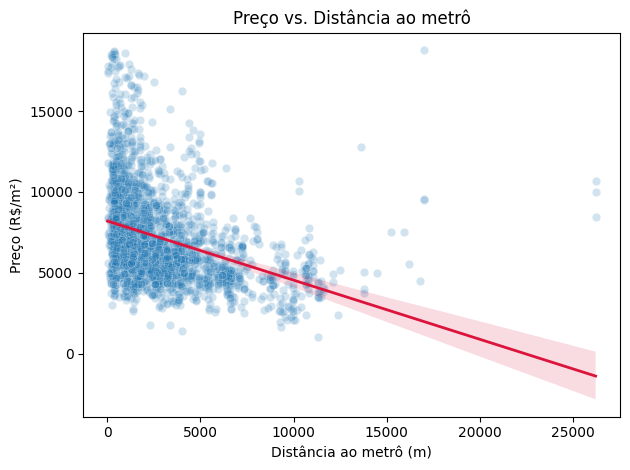

In [11]:
from haversine import haversine
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# -----------------------------
# 1.1 Distância exata ao metrô
# -----------------------------
# cria tuplas lat/lon p/ acelerar lookup
gdf_metro = gdf_metro.to_crs(epsg=4326)  # Garantir que está no sistema WGS84
gdf_imoveis = gdf_imoveis.to_crs(epsg=4326)  # Garantir que está no sistema WGS84



metro_coords = list(zip(gdf_metro.lat, gdf_metro.lon))

def min_dist(row):
    _, d = min(
        ((i, haversine((row.lat, row.lon), c)*1000) for i, c in enumerate(metro_coords)),
        key=lambda x: x[1]
    )
    return d

gdf_imoveis["dist_hav"] = gdf_imoveis.apply(min_dist, axis=1)

# Corrigir dist caso esteja como string com vírgula
if "dist" in gdf_imoveis.columns and gdf_imoveis["dist"].dtype == "object":
    gdf_imoveis["dist"] = gdf_imoveis["dist"].str.replace(",", ".").astype(float)

# Calcular erro médio entre distância declarada e distância calculada via haversine
print("Erro médio (m):", np.mean(np.abs(gdf_imoveis["dist"] - gdf_imoveis["dist_hav"])))


# -----------------------------
# 1.2 Correlação preço × distância
# -----------------------------
gdf_imoveis["unit"] = (
    gdf_imoveis["unit"]
    .astype(str)
    .str.replace(".", "", regex=False)
    .str.replace(",", ".", regex=False)
    .astype(float)
)

corr = gdf_imoveis["unit"].corr(gdf_imoveis["dist_hav"])
print(f"Correlação Pearson (unit × dist_hav): {corr:.3f}")

sns.scatterplot(data=gdf_imoveis, x="dist_hav", y="unit", alpha=0.2)
sns.regplot(data=gdf_imoveis, x="dist_hav", y="unit",
            scatter=False, color="crimson", line_kws={"lw":2})
plt.xlabel("Distância ao metrô (m)"); plt.ylabel("Preço (R$/m²)")
plt.title("Preço vs. Distância ao metrô"); plt.tight_layout()
plt.show()


### 
O gráfico acima apresenta a relação entre o preço dos imóveis por metro quadrado (R$/m²) e a distância até a estação de metrô mais próxima. 

Cada ponto representa um imóvel, enquanto a linha vermelha indica a tendência geral obtida por regressão linear.

- É possível observar uma **correlação negativa significativa**: imóveis localizados **mais próximos do metrô tendem a ser mais caros**. À medida que a distância aumenta, o preço por metro quadrado tende a diminuir. Essa relação sugere que a **acessibilidade ao transporte público é um fator importante de valorização imobiliária** na cidade de São Paulo.

Além disso, a maior concentração de pontos está abaixo de 1000 metros de distância, indicando que muitos imóveis de alto valor estão próximos a estações. Essa análise pode ser útil para modelagem preditiva de preços e também para embasar decisões de planejamento urbano e investimento.

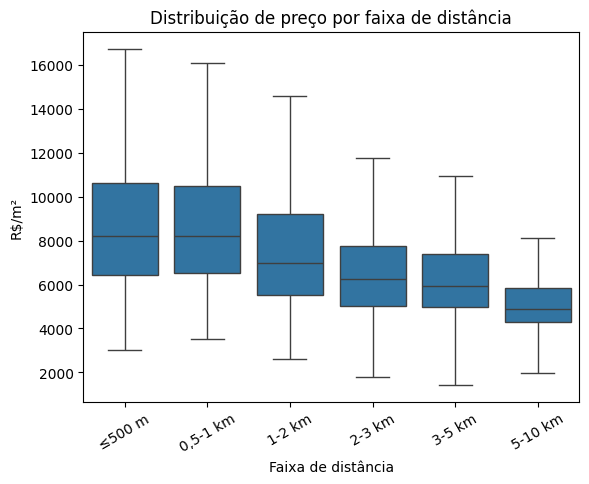

          count    mean  median
dist_bin                       
≤500 m      335  8839.0  8219.0
0,5‑1 km    318  8699.0  8213.0
1‑2 km      554  7686.0  6962.0
2‑3 km      400  6633.0  6244.0
3‑5 km      474  6393.0  5938.0
5‑10 km     342  5167.0  4885.0


C:\Users\PC\AppData\Local\Temp\ipykernel_6208\2610370243.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(gdf_imoveis.groupby("dist_bin")["unit"].agg(["count","mean","median"]).round(0))


In [12]:
bins = [0, 500, 1000, 2000, 3000, 5000, 10000]
labels = ["≤500 m","0,5‑1 km","1‑2 km","2‑3 km","3‑5 km","5‑10 km"]
gdf_imoveis["dist_bin"] = pd.cut(gdf_imoveis["dist_hav"], bins=bins, labels=labels)

ax = sns.boxplot(x="dist_bin", y="unit", data=gdf_imoveis, showfliers=False)
ax.set_xlabel("Faixa de distância"); ax.set_ylabel("R$/m²")
ax.set_title("Distribuição de preço por faixa de distância"); plt.xticks(rotation=30)
plt.show()

print(gdf_imoveis.groupby("dist_bin")["unit"].agg(["count","mean","median"]).round(0))


### Resultados

Abaixo estão as principais estatísticas por categoria de distância:

- Imóveis **a até 500 metros** de estações de metrô possuem **preço por m² mais elevado** (R$8.827/m² em média).
- Imóveis **entre 500m e 1km** também mantêm um valor alto e estável (R$8.690/m²).
- Já imóveis **acima de 1km** apresentam um valor significativamente menor (R$6.570/m²).

Essa diferença **reforça a valorização de imóveis bem conectados ao transporte público**, informação crucial para investidores, urbanistas e planejadores de política habitacional.

O gráfico de boxplot abaixo reforça essas diferenças, mostrando também a variabilidade dentro de cada grupo.


## 3.4 Interpolacao Espacial Kriging

###  O problema

Imagine que você possui medições de temperatura do fundo do mar feitas por sensores em pontos esparsos. Você quer criar um **mapa contínuo** para visualizar a variação da temperatura ao longo de toda a região.

Para isso, usamos **interpolação espacial** — uma técnica que estima valores em locais onde não há dados, com base na localização e valor dos pontos conhecidos.


### Comparando abordagens

| Método | Como funciona | Limitações |
|--------|----------------|-------------|
| **IDW** (Inverse Distance Weighting) | A média ponderada dos pontos vizinhos, com pesos baseados na distância (“pontos mais próximos são mais parecidos”) | Não considera padrões espaciais complexos, só a distância |
| **Kriging** | Ajusta um modelo estatístico (variograma) para estimar valores com base na **estrutura espacial do dado** | Mais complexo, exige ajuste de modelo e interpretação mais técnica |


### O que é o Kriging?

Kriging é uma técnica de interpolação **baseada em modelos estatísticos** que incorporam:

- A **distância** entre os pontos
- A **variabilidade dos dados**
- A **direção ou tendência** dos dados (em versões mais avançadas)

Ideal para fenômenos naturais como temperatura, poluição, teor de minério, etc.


In [13]:
from matplotlib import pyplot as plt
from pykrige.ok import OrdinaryKriging
from scipy.interpolate import griddata
# Recarregar o CSV pulando a linha com as unidades
df = pd.read_csv("datasets/temp_sea_bottom/northeast_atlatic_sea_bottom_temp.csv")
# Garantir conversão correta para tipos numéricos
df["latitude"] = pd.to_numeric(df["latitude"], errors="coerce")
df["longitude"] = pd.to_numeric(df["longitude"], errors="coerce")
df["sea_bottom_temperature"] = pd.to_numeric(df["sea_bottom_temperature"], errors="coerce")

# Remover linhas com valores faltantes
df = df.dropna(subset=["latitude", "longitude", "sea_bottom_temperature"])

# Exibir preview
df.head()


,time,latitude,longitude,sea_bottom_temperature
0,2017-11-30T00:00:00Z,48.00625,-17.99375,2.149733
1,2017-11-30T00:00:00Z,48.00625,-17.98125,2.149733
2,2017-11-30T00:00:00Z,48.00625,-17.96875,2.149733
3,2017-11-30T00:00:00Z,48.00625,-17.95625,2.149733
4,2017-11-30T00:00:00Z,48.00625,-17.94375,2.172670


In [14]:

# Amostrar 500 pontos para agilizar a krigagem
df_sample = df.sample(n=1000, random_state=42)

# Extrair variáveis
x = df_sample["longitude"].values
y = df_sample["latitude"].values
z = df_sample["sea_bottom_temperature"].values


In [15]:
# Interpolação com IDW usando griddata
grid_x, grid_y = np.meshgrid(
    np.linspace(x.min(), x.max(), 100),
    np.linspace(y.min(), y.max(), 100)
)

zi_idw = griddata((x, y), z, (grid_x, grid_y), method='linear')


In [16]:

OK = OrdinaryKriging(x, y, z, variogram_model='linear', verbose=False, enable_plotting=False)
zi_krig, _ = OK.execute("grid", grid_x[0], grid_y[:, 0])


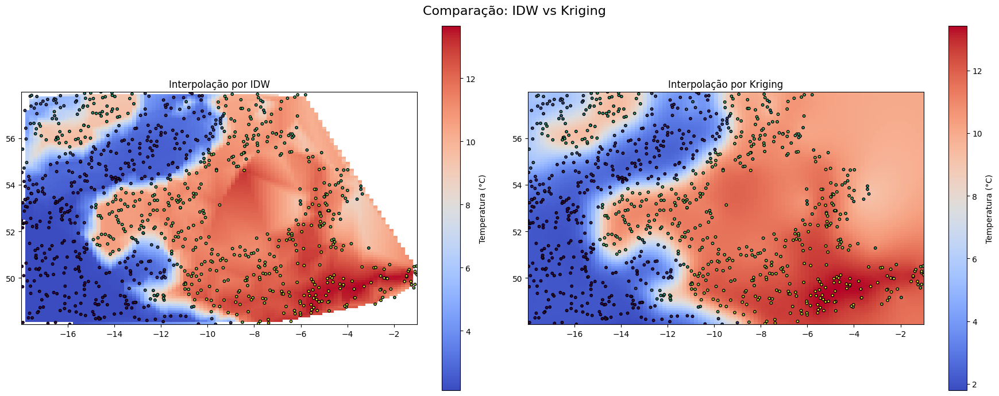

In [17]:
# Comparação visual
fig, axs = plt.subplots(1, 2, figsize=(18, 7))

# IDW
im1 = axs[0].imshow(zi_idw, extent=(x.min(), x.max(), y.min(), y.max()), origin='lower', cmap='coolwarm')
axs[0].set_title("Interpolação por IDW")
axs[0].scatter(x, y, c=z, edgecolors='k', s=10)
plt.colorbar(im1, ax=axs[0], label="Temperatura (°C)")

# Kriging
im2 = axs[1].imshow(zi_krig, extent=(x.min(), x.max(), y.min(), y.max()), origin='lower', cmap='coolwarm')
axs[1].set_title("Interpolação por Kriging")
axs[1].scatter(x, y, c=z, edgecolors='k', s=10)
plt.colorbar(im2, ax=axs[1], label="Temperatura (°C)")

plt.suptitle("Comparação: IDW vs Kriging", fontsize=16)
plt.tight_layout()
plt.show()


A imagem acima compara dois métodos de interpolação espacial aplicados à estimativa de temperaturas em uma região:

- **IDW (Inverse Distance Weighting)** — à esquerda;
- **Kriging** — à direita.

####  O que os mapas mostram

Ambos os mapas exibem uma superfície contínua de temperatura (em °C) gerada a partir de uma nuvem de pontos amostrados (indicados pelos círculos). As cores representam diferentes valores de temperatura, com tons mais quentes indicando temperaturas mais altas.

####  Interpolação por IDW

O método IDW estima os valores em locais não amostrados com base em uma média ponderada dos pontos vizinhos, onde os mais próximos têm maior influência. É simples e rápido, mas pode gerar superfícies com **transições abruptas** e **zonas artificiais**, como pode ser visto na granularidade do mapa à esquerda.

####  Interpolação por Kriging

O Kriging é um método geoestatístico que considera tanto a distância quanto a **estrutura espacial de variância** entre os pontos (modelada via variograma). Isso permite gerar uma superfície mais **suave, contínua e estatisticamente confiável**, como visto no mapa à direita.

####  Conclusão

- O IDW é útil em aplicações rápidas ou quando não se tem variograma definido;
- O Kriging oferece resultados mais robustos, principalmente em aplicações que exigem precisão (geologia, agricultura de precisão, recursos naturais).

Essa comparação ilustra como a escolha do método de interpolação pode impactar diretamente a interpretação dos dados espaciais.

# Índice
- [4.1 Camadas de Mapas Base](#41-camadas-de-mapas-base)
- [4.2 Mapa de Pontos](#42-mapa-de-pontos)
- [4.3 Mapa Coroplético](#43-mapa-coropletico)
- [4.4 Mapa de Pontos Classificados por Faixa de Preço](#44-mapa-de-pontos-classificados-por-faixa-de-preco)
- [4.5 Heatmap de Densidade de Imóveis](#45-heatmap-de-densidade-de-imoveis)
- [4.6 Clusterização de Pontos com Folium](#46-clusterizacao-de-pontos-com-folium)
- [4.7 Visualização Temporal com Mapa](#47-visualizacao-temporal-com-mapa)
- [4.8 Heatmap Temporal Acumulativo](#48-heatmap-temporal-acumulativo)


## 4. Visualização Geoespacial

A visualização geoespacial é uma etapa fundamental para compreender a distribuição espacial de fenômenos. Ela permite comunicar padrões, identificar clusters e tomar decisões baseadas em localização de forma mais eficiente.

### 4.1 Camadas de Mapas Base

Folium permite adicionar diferentes estilos de mapas base (tiles), como ruas, satélite e versões claras ou escuras. Essas camadas ajudam a adaptar a visualização ao tipo de dado apresentado.

In [1]:
import folium

# Criar o mapa sem tile inicial (usaremos múltiplos)
m = folium.Map(location=[1.3521, 103.8198], zoom_start=12, tiles=None)

# CartoDB (claro e escuro)
folium.TileLayer("CartoDB positron", name="CartoDB Claro").add_to(m)
folium.TileLayer("CartoDB dark_matter", name="CartoDB Escuro").add_to(m)

# Stamen
folium.TileLayer("Stamen Toner", name="Stamen Toner (PB)", attr="© OpenStreetMap contributors").add_to(m)
folium.TileLayer("Stamen Terrain", name="Stamen Terreno", attr="© OpenStreetMap contributors"	).add_to(m)
folium.TileLayer("Stamen Watercolor", name="Stamen Aquarela", attr="© OpenStreetMap contributors").add_to(m)

# Mapbox Streets (personalizado - requer token se premium)
folium.TileLayer(
    tiles='https://api.mapbox.com/styles/v1/mapbox/streets-v11/tiles/{z}/{x}/{y}?access_token=YOUR_MAPBOX_TOKEN',
    attr='Map data © OpenStreetMap contributors, Imagery © Mapbox',
    name='Mapbox Streets',
    overlay=False,
    control=True
).add_to(m)

# Esri World Imagery (satélite)
folium.TileLayer(
    tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
    attr='Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community',
    name='Esri Satélite',
    overlay=False,
    control=True
).add_to(m)

# OpenStreetMap tradicional
folium.TileLayer("OpenStreetMap", name="OpenStreetMap").add_to(m)

# Adicionar controle de camadas
folium.LayerControl().add_to(m)

m


### 4.2 Mapa de Pontos

Mapas de pontos são usados para mostrar a localização de eventos ou objetos, como imóveis, escolas ou ocorrências de crimes.

In [2]:
import pandas as pd
import folium

# Carregar dados geocodificados de imóveis (já com latitude/longitude)
df = pd.read_csv("datasets/Singapore/geocodificados.csv")
df = df.dropna(subset=["latitude", "longitude"])



# Adicionar marcadores para cada imóvel
for _, row in df.iterrows():
    folium.CircleMarker(
        location=(row["latitude"], row["longitude"]),
        radius=5,
        color="blue",
        fill=True,
        fill_opacity=0.6,
        popup=f"${row['resale_price']:.0f}"
    ).add_to(m)

m


### 4.3 Mapa Coropletico

Mapas coropléticos permitem representar atributos agregados por regiões, como preço médio por bairro ou densidade populacional.

In [3]:
import geopandas as gpd
import folium
import pandas as pd

# Carregar dados dos imóveis
df = pd.read_csv("datasets/Singapore/geocodificados.csv")
df["preco_m2"] = df["resale_price"] / df["floor_area_sqm"]

# Padronizar nomes dos bairros
df["town_clean"] = df["town"].str.lower().str.strip()

# Calcular média de preço por região padronizada
media_por_town = df.groupby("town_clean")["preco_m2"].mean().reset_index()

# Carregar GeoJSON dos bairros
gdf_towns = gpd.read_file("datasets/Singapore/district_and_planning_area.geojson")
gdf_towns["planning_area_clean"] = gdf_towns["planning_area"].str.lower().str.strip()

# Merge com nomes padronizados
gdf_towns = gdf_towns.merge(media_por_town, left_on="planning_area_clean", right_on="town_clean")

# Criar mapa coroplético
m_choro = folium.Map(location=[1.3521, 103.8198], zoom_start=12)
folium.Choropleth(
    geo_data="datasets/Singapore/district_and_planning_area.geojson",
    data=gdf_towns,
    columns=["planning_area", "preco_m2"],
    key_on="feature.properties.planning_area",
    fill_color="BuGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_color="black",  # Cor para regiões sem dados
    nan_fill_opacity=0.4,
    legend_name="Preço médio por m² (SGD)"
).add_to(m_choro)

m_choro



### 4.4 Mapa de Pontos Classificados por Faixa de Preco

Podemos agrupar visualmente os imóveis com base no preço por metro quadrado, utilizando diferentes cores para faixas de valores.

In [4]:
# Calcular preço por metro quadrado
df["preco_m2"] = df["resale_price"] / df["floor_area_sqm"]

# Definir os quartis
q1 = df["preco_m2"].quantile(0.25)
q3 = df["preco_m2"].quantile(0.75)

# Função para classificar
def classificar_preco(valor):
    if valor < q1:
        return "Barato"
    elif valor < q3:
        return "Médio"
    else:
        return "Caro"

# Aplicar classificação e definir cores
df["categoria"] = df["preco_m2"].apply(classificar_preco)
cores = {"Barato": "green", "Médio": "orange", "Caro": "red"}

# Mapa com cores por categoria
m2 = folium.Map(location=[1.3521, 103.8198], zoom_start=12)
df = df.dropna()
for _, row in df.iterrows():
    folium.CircleMarker(
        location=(row["latitude"], row["longitude"]),
        radius=5,
        color=cores[row["categoria"]],
        fill=True,
        fill_opacity=0.75,
        popup=f"{row['categoria']} - ${row['preco_m2']:.0f}/m²"
    ).add_to(m2)

m2


Podemos agrupar visualmente os imóveis com base no preço por metro quadrado, utilizando diferentes cores para faixas de valores.

### 4.5 Heatmap de Densidade de Imoveis


Um heatmap ajuda a identificar as regiões com maior concentração de pontos (ex: imóveis cadastrados).

In [5]:
from folium.plugins import HeatMap

# Mapa de calor da densidade de imóveis
m3 = folium.Map(location=[1.3521, 103.8198], zoom_start=12)
HeatMap(data=df[["latitude", "longitude"]]).add_to(m3)
m3


### 4.6 Clusterizacao de Pontos com Folium

Utilizando `MarkerCluster` conseguimos agrupar automaticamente pontos muito próximos, facilitando a visualização em áreas densas.

In [6]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Carregar os dados
df = pd.read_csv("datasets/Singapore/geocodificados.csv")

# Remover registros com coordenadas ausentes
df = df.dropna(subset=["latitude", "longitude"])

# Criar mapa base
m = folium.Map(location=[1.3521, 103.8198], zoom_start=12)

# Criar o cluster de marcadores
marker_cluster = MarkerCluster().add_to(m)

# Adicionar os pontos ao cluster
for _, row in df.iterrows():
    popup_text = f"""
    <b>Preço:</b> ${row['resale_price']:,.0f}<br>
    <b>Área:</b> {row['floor_area_sqm']} m²<br>
    <b>Tipo:</b> {row['flat_type']}<br>
    <b>Bairro:</b> {row['town']}
    """
    folium.Marker(
        location=(row["latitude"], row["longitude"]),
        popup=folium.Popup(popup_text, max_width=250)
    ).add_to(marker_cluster)

# Exibir o mapa
m


### 4.7 Visualizacao Temporal com Mapa

Mapas com componente temporal permitem explorar como variáveis geoespaciais evoluem ao longo do tempo. Ao associar atributos temporais a localizações, é possível animar eventos, detectar tendências.

Neste exemplo, utilizamos a data de lançamento dos imóveis para criar uma visualização que combina localização geográfica com a dimensão do tempo. Esse tipo de visualização é útil para identificar padrões de expansão urbana, mudanças na densidade construtiva e movimentos de crescimento regional ao longo dos anos.

In [7]:
from folium.plugins import TimestampedGeoJson
import folium
import pandas as pd

# Carregar os dados
df = pd.read_csv("datasets/Singapore/geocodificados.csv")

# Corrigir o tipo de dado e criar timestamp por lease
df["lease_date"] = pd.to_datetime(df["lease_commence_date"].astype(int).astype(str) + "-01-01")
df["timestamp"] = df["lease_date"].dt.strftime("%Y-%m-%d")

# Construir GeoJSON
features = []
for _, row in df.dropna(subset=["latitude", "longitude"]).iterrows():
    feature = {
        "type": "Feature",
        "geometry": {
            "type": "Point",
            "coordinates": [row["longitude"], row["latitude"]],
        },
        "properties": {
            "time": row["timestamp"],
            "popup": f"{row['town']}<br>Lease: {row['lease_commence_date']}<br>Preço: ${row['resale_price']:,.0f}",
            "icon": "circle",
            "iconstyle": {
                "fillColor": "blue",
                "fillOpacity": 0.6,
                "stroke": "true",
                "radius": 5
            },
        },
    }
    features.append(feature)

geojson = {
    "type": "FeatureCollection",
    "features": features
}

# Criar mapa
m_time = folium.Map(location=[1.3521, 103.8198], zoom_start=12)
TimestampedGeoJson(geojson, period="P1Y", add_last_point=True).add_to(m_time)
m_time


### 4.8 Heatmap Temporal Acumulativo

Com o `HeatMapWithTime`, é possível visualizar a evolução da densidade geográfica ao longo do tempo. No caso dos imóveis, esse recurso permite observar como a urbanização se expandiu ano após ano.

Ao invés de mostrar apenas os imóveis lançados em cada ano isoladamente, aqui acumulamos os dados: a cada nova etapa da animação, os imóveis dos anos anteriores são mantidos. Isso permite perceber o crescimento urbano e a concentração de novas unidades ao longo das décadas.

Essa visualização é especialmente útil para análises temporais e urbanísticas.

In [8]:
from folium.plugins import HeatMapWithTime
import pandas as pd
import folium

# Carregar e preparar os dados
df = pd.read_csv("datasets/Singapore/geocodificados.csv")
df = df.dropna(subset=["latitude", "longitude", "lease_commence_date"])
df["lease_commence_date"] = df["lease_commence_date"].astype(int)

# Ordenar anos
anos = sorted(df["lease_commence_date"].unique())
heat_data = []
pontos_acumulados = []

# Construir lista acumulativa de pontos
for ano in anos:
    subset = df[df["lease_commence_date"] == ano]
    novos_pontos = subset[["latitude", "longitude"]].values.tolist()
    pontos_acumulados.extend(novos_pontos)
    heat_data.append(pontos_acumulados.copy())

# Criar o mapa
m_heat = folium.Map(location=[1.3521, 103.8198], zoom_start=12)

# Adicionar heatmap com animação acumulativa
HeatMapWithTime(
    heat_data,
    index=anos,
    auto_play=True,
    radius=10,
    max_opacity=0.8
).add_to(m_heat)

# Estatísticas adicionais
contagem = df["lease_commence_date"].value_counts().sort_index()
ano_top = contagem.idxmax()
qtd_top = contagem.max()
print(f"O ano com mais lançamentos foi {ano_top}, com {qtd_top} imóveis.")

m_heat


O ano com mais lançamentos foi 1985, com 92 imóveis.
